<a href="https://colab.research.google.com/github/bernhardtandy/ProjectsMLAI/blob/main/Final_Project_Part_0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Projects in Machine Learning and AI Final Project**
## *Music Generation using Causal Language Modeling*
### **Part 0**
##### **Andy Bernhardt**
##### **bernha@rpi.edu**

---
## **Introduction and Related Work**

As an avid musician, I am interested in applications of machine learning and AI in the domain of music, which can include tasks such as music modeling, music authorship attribution, music genre classification, machine listening, and artificial music composition. In this project, we focus on the task of artificial music composition. Briot and Pachet [1] describe a variety of deep learning methods that have been applied to the task of music generation, which include WaveNet, Anticipation-RNN, and applications of architectures such as Variational Recurrent Autoencoders (VRAE) and Restricted Boltzmann Machines (RBM) (Briot and Pachet 2017). They note that some of the challenges of this task include: 

*   "control", which they define as "tonality conformance, maximum number of repeated notes, and rhythm"
*   "structure", which they define as "a sense of direction"
* "creativity", which they define as in opposition to "imitation" and "risk of plagiarism"
* "interactivity", which they define as how much a composer can interact with the automated generation process

We note that of the approaches described in the paper, none of them use a language modeling approach or explicitly use natural language processing techniques to solve the problem (although recurrent models are frequently used). Recently, Google Research published "AudioLM: a Language Modeling Approach to
Audio Generation" [2], which describes a novel approach to audio generation using the ideas of language modeling (Borsos et al. 2022). In their approach, they map the "input audio to a sequence of discrete tokens" (testing a variety of audio tokenization schemes), and train decoder-only transformer models in this tokenized space, on a variety of audio datasets and domains, to generate output audio and continuations of the input. They mainly test this approach on speech and the task of speech continuation, but additionally test on a large piano recording dataset, finding that the model "generat[es] coherent piano music continuations, despite being trained without any symbolic representation of music". By examples provided at https://google-research.github.io/seanet/audiolm/examples/), we can see firsthand that this model can generate reasonable continuations to piano music, which is exciting. 

In this project, we try a new approach to music generation, referencing some of the ideas presented by AudioLM. Given a (much smaller) dataset of piano music recordings, we first determine a way to tokenize the music data. Then, we train GPT-2 from scratch on this tokenized piano recording dataset. At various intermediate training epochs with different training and validation losses, we test the model on generating continuations to examples from the testing set. Finally, after 30 epochs, we test generation without an input prompt and investigate alternate ways of decoding such as beam search and top-k and top-p sampling.  

[1] Jean-Pierre Briot, & François Pachet (2017). Music Generation by Deep Learning - Challenges and Directions. CoRR, abs/1712.04371. https://link.springer.com/content/pdf/10.1007/s00521-018-3813-6.pdf.

[2] Borsos, Z., Marinier, R., Vincent, D., Kharitonov, E., Pietquin, O., Sharifi, M., Teboul, O., Grangier, D., Tagliasacchi, M., & Zeghidour, N.. (2022). AudioLM: a Language Modeling Approach to Audio Generation. https://arxiv.org/pdf/2209.03143.pdf.

---
## **Resources**

We refer to the following resources throughout the course of this project:

* MAESTRO Dataset: https://magenta.tensorflow.org/datasets/maestro
* Tensorflow tutorial for music generation with an RNN: https://www.tensorflow.org/tutorials/audio/music_generation
* Pretty MIDI: A Python library for working with MIDI files: https://craffel.github.io/pretty-midi/
* Pyfluidsynth: A Python library for generating audio from MIDI files: https://github.com/nwhitehead/pyfluidsynth
* Pypianoroll: A Python library for converting piano roll matrices into MIDI files: https://salu133445.github.io/pypianoroll/index.html
* Huggingface tutorial for training a causal language model (CLM) from scratch: https://huggingface.co/course/chapter7/6
* Tutorial for training a BERT model (MLM) from scratch: https://towardsdatascience.com/how-to-train-a-bert-model-from-scratch-72cfce554fc6 (We refer to this to train the tokenizer)
* Documentation for Huggingface Byte-Pair Encoding (BPE) tokenizer: https://huggingface.co/docs/transformers/tokenizer_summary#bytepair-encoding-bpe 
* Huggingface tutorial for generating text using various decoding methods: https://huggingface.co/blog/how-to-generate


---
## **Setup**

In [ ]:
# Install required libraries for project
!pip install pretty_midi
!sudo apt install -y fluidsynth
!pip install --upgrade pyfluidsynth
!pip install pypianoroll
!pip install huggingface
!pip install transformers
!pip install datasets

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Reading package lists... Done
Building dependency tree       
Reading state information... Done
fluidsynth is already the newest version (1.1.9-1).
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'sudo apt autoremove' to remove it.
0 upgraded, 0 newly installed, 0 to remove and 7 not upgraded.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 5.8 MB 7.1 MB/s 
     |████████████████████████████████| 7.6 MB 77.0 MB/s 
     |████████████████████████████████|

In [ ]:
# Import required libraries for project
import math
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

import collections
import datetime
import fluidsynth
import glob
import pathlib
import pretty_midi

from IPython import display
from typing import Dict, List, Optional, Sequence, Tuple

from google.colab import drive
import sys
import json
from datasets import load_dataset, Dataset, DatasetDict
from tokenizers import ByteLevelBPETokenizer
from tokenizers.processors import TemplateProcessing
import os
from transformers import GPT2TokenizerFast
from transformers import AutoTokenizer, GPT2LMHeadModel, AutoConfig
from transformers import DataCollatorForLanguageModeling
from transformers import Trainer, TrainingArguments
from huggingface_hub import notebook_login
from transformers import GPT2LMHeadModel
import pypianoroll as ppr

In [ ]:
# Set a random seed and sampling rate for audio playback
seed = 42
np.random.seed(seed)

# Sampling rate for audio playback
_SAMPLING_RATE = 44100

In [ ]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Add final project folder to path
import sys
sys.path.append('/content/drive/MyDrive/ProjectsMLAI/Project')
file_path = "/content/drive/MyDrive/ProjectsMLAI/Project/maestro/maestro-v3.0.0/"

---
## **Dataset and Exploratory Data Analysis**

In this project, we will use the MAESTRO dataset (other considered datasets were AudioSet (https://research.google.com/audioset/dataset/index.html) and EMOPIA (https://annahung31.github.io/EMOPIA/), but MAESTRO was best suited for the task). "MAESTRO (MIDI and Audio Edited for Synchronous TRacks and Organization) is a dataset composed of about 200 hours of virtuosic piano performances captured with fine alignment (~3 ms) between note labels and audio waveforms". The data consists of paired audio and MIDI recordings from the International Piano-e-Competition (https://piano-e-competition.com/) over 10 years, and these recordings are split into individual pieces and are annotated with composer, title, and year of performance (in a metadata file). The repertoire is mostly from the "17th to early 20th century", and a train/validation/test split is provided in the dataset. In the project, we will use the MIDI dataset from MAESTRO v.3.0.0, as the raw audio data is very large. 

Link to dataset: https://magenta.tensorflow.org/datasets/maestro

In [ ]:
# Open metadata file
metadata = pd.read_csv("/content/drive/MyDrive/ProjectsMLAI/Project/maestro/maestro-v3.0.0/maestro-v3.0.0.csv")
pd.set_option('display.max_columns', None)

In [ ]:
# Show metadata file
metadata
# There are 1276 recordings total

,canonical_composer,canonical_title,split,year,midi_filename,audio_filename,duration
0,Alban Berg,Sonata Op. 1,train,2018,2018/MIDI-Unprocessed_Chamber3_MID--AUDIO_10_R...,2018/MIDI-Unprocessed_Chamber3_MID--AUDIO_10_R...,698.661160
1,Alban Berg,Sonata Op. 1,train,2008,2008/MIDI-Unprocessed_03_R2_2008_01-03_ORIG_MI...,2008/MIDI-Unprocessed_03_R2_2008_01-03_ORIG_MI...,759.518471
2,Alban Berg,Sonata Op. 1,train,2017,2017/MIDI-Unprocessed_066_PIANO066_MID--AUDIO-...,2017/MIDI-Unprocessed_066_PIANO066_MID--AUDIO-...,464.649433
3,Alexander Scriabin,"24 Preludes Op. 11, No. 13-24",train,2004,2004/MIDI-Unprocessed_XP_21_R1_2004_01_ORIG_MI...,2004/MIDI-Unprocessed_XP_21_R1_2004_01_ORIG_MI...,872.640588
4,Alexander Scriabin,"3 Etudes, Op. 65",validation,2006,2006/MIDI-Unprocessed_17_R1_2006_01-06_ORIG_MI...,2006/MIDI-Unprocessed_17_R1_2006_01-06_ORIG_MI...,397.857508
...,...,...,...,...,...,...,...
1271,Wolfgang Amadeus Mozart,"Sonata in F Major, K280",test,2004,2004/MIDI-Unprocessed_XP_14_R1_2004_04_ORIG_MI...,2004/MIDI-Unprocessed_XP_14_R1_2004_04_ORIG_MI...,241.470442
1272,Wolfgang Amadeus Mozart,"Sonata in F Major, K280",train,2004,2004/MIDI-Unprocessed_XP_14_R1_2004_04_ORIG_MI...,2004/MIDI-Unprocessed_XP_14_R1_2004_04_ORIG_MI...,114.696243
1273,Wolfgang Amadeus Mozart,"Sonata in F Major, K533",validation,2004,2004/MIDI-Unprocessed_SMF_12_01_2004_01-05_ORI...,2004/MIDI-Unprocessed_SMF_12_01_2004_01-05_ORI...,1139.198478
1274,Wolfgang Amadeus Mozart,"Sonata in F Major, K533/K494",validation,2018,2018/MIDI-Unprocessed_Recital17-19_MID--AUDIO_...,2018/MIDI-Unprocessed_Recital17-19_MID--AUDIO_...,1068.751602


In [ ]:
# Show the sizes of the provided train/validation/test split
metadata['split'].value_counts()
# There are 962 training recordings, 137 validation recordings, and 177 test recordings

train         962
test          177
validation    137
Name: split, dtype: int64

In [ ]:
# Show number of recordings for each composer
metadata['canonical_composer'].value_counts()
# The most frequent composers are Chopin, Schubert, Beethoven, Bach, and Liszt

Frédéric Chopin                                       201
Franz Schubert                                        186
Ludwig van Beethoven                                  146
Johann Sebastian Bach                                 145
Franz Liszt                                           131
Sergei Rachmaninoff                                    59
Robert Schumann                                        49
Claude Debussy                                         45
Joseph Haydn                                           40
Wolfgang Amadeus Mozart                                38
Alexander Scriabin                                     35
Domenico Scarlatti                                     31
Felix Mendelssohn                                      28
Johannes Brahms                                        26
Franz Schubert / Franz Liszt                           10
Isaac Albéniz                                           7
Muzio Clementi                                          6
Pyotr Ilyich T

In [ ]:
# Show statistics for the durations of the recordings
metadata['duration'].describe()
# The average length of a recording is 560.46 seconds (~ 9 minutes)
# The recordings range from 45 wseconds to 2624 seconds (~ 1 minute to ~ 44 minutes)

count    1276.000000
mean      560.463595
std       443.057431
min        45.155208
25%       261.981576
50%       429.168241
75%       685.018817
max      2624.663508
Name: duration, dtype: float64

In [ ]:
# This function displays an audio clip given a Pretty MIDI object
def display_audio(pm, seconds=60):
  waveform = pm.fluidsynth(fs=_SAMPLING_RATE)
  waveform_short = waveform[:seconds*_SAMPLING_RATE]
  return display.Audio(waveform_short, rate=_SAMPLING_RATE)

In [ ]:
# Show an audio example from the dataset by opening the corresponding MIDI file using Pretty MIDI and generating audio using Pyfluidsynth
df_chopin = metadata[metadata['canonical_composer'] == 'Frédéric Chopin']
example_file = df_chopin[df_chopin['canonical_title'] == "Etude Op. 25 No. 11 in A Minor"].iloc[0]['midi_filename']
pm = pretty_midi.PrettyMIDI(file_path + example_file)
display_audio(pm)

In [ ]:
# Show a second audio example from the dataset by opening the corresponding MIDI file using Pretty MIDI and generating audio using Pyfluidsynth
df_liszt = metadata[metadata['canonical_composer'] == 'Franz Liszt']
example_file = df_liszt.iloc[130]['midi_filename']
pm_2 = pretty_midi.PrettyMIDI(file_path + example_file)
display_audio(pm_2)

In [ ]:
# Set sampling rate to 100
sampling_rate = 100

In [ ]:
# Obtain a chromagram sampled at 100 times per second from the example Pretty MIDI object
example_chroma = pm.get_chroma(fs=sampling_rate, times=None, pedal_threshold=64)

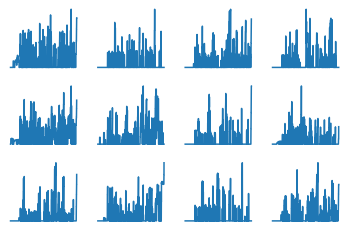

In [ ]:
# Show the intensity of each note over the course of an example piece
time = np.linspace(0, 23860, 23861)
for i in range(12):
  plt.subplot(3, 4, i + 1)
  note = example_chroma[i]
  plt.plot(time, note)
  plt.axis('off')

plt.show()

In [ ]:
# Obtain a piano roll sampled at 100 times per second from the example Pretty MIDI object
example_piano_roll = pm.get_piano_roll(fs=sampling_rate, times=None, pedal_threshold=64)

([<matplotlib.lines.Line2D at 0x7fe802654290>],
 array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]))

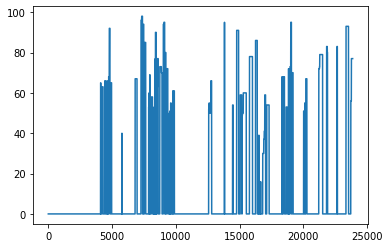

In [ ]:
# Show a plot of the intensity of middle C over the course of the piece
middle_c = example_piano_roll[59]
time = np.linspace(0, 23860, 23861)
plt.plot(time, middle_c)
# In this project, we will use piano rolls rather than chromagrams, as they are more descriptive of the music

---
## **Data Preprocessing**

In this section, we preprocess the original MIDI data so that it can be used to train a causal language model (GPT-2). We note that for a transformer-based language model such as GPT-2, the model expects discretely tokenized inputs, where each token represents a member of a vocabulary. In a natural language model, building a vocabulary and corresponding tokenization is straightforward, as we can consider words or sub-words of a language to be tokens; the language itself is discrete because there are limited number of valid words. However, what determines a “musical token” is less clear, and the frequencies and intensities in music, as well as the sound itself, are continuous. As a result, we must design a way to quantize/discretize music in order for it to be suitable for training GPT-2. The way I have designed to tokenize a MIDI recording is as follows, and involves:

1.   Extracting piano rolls from MIDI files. This loses information based on the sampling rate of the piano roll 
2.   Converting piano rolls to strings. We represent each time step of the piano roll as a word (again, losing some information), and represent the entire piano roll as a string
3.   Tokenizing the piano roll strings. We train a Byte-Level BPE Tokenizer on the training strings.

After preprocessing the data, we show some examples of the loss of information from these encoding steps (1 and 2).

### **Extracting Piano Rolls from MIDI Files**



In [ ]:
# Obtain piano rolls from each MIDI file in the dataset
# The 88 notes on the piano are indices 20 to 108 in the piano roll, which ranges from 0 to 127
# We keep only these 88 notes as all other values are zero
train_piano_rolls = []
val_piano_rolls = []
test_piano_rolls = []
sampling_rate = 10
i = 0
for index, row in metadata.iterrows():
  split = getattr(row, 'split')
  file_name = getattr(row, 'midi_filename')
  print(f"{i}: {file_name}")
  pm = pretty_midi.PrettyMIDI(file_path + file_name)
  piano_roll = pm.get_piano_roll(fs=sampling_rate, times=None, pedal_threshold=64)
  if (split == 'train'):
    train_piano_rolls.append(piano_roll[20:108])
  elif (split == 'validation'):
    val_piano_rolls.append(piano_roll[20:108])
  else:
    test_piano_rolls.append(piano_roll[20:108])
  i += 1

0: 2018/MIDI-Unprocessed_Chamber3_MID--AUDIO_10_R3_2018_wav--1.midi
1: 2008/MIDI-Unprocessed_03_R2_2008_01-03_ORIG_MID--AUDIO_03_R2_2008_wav--2.midi
2: 2017/MIDI-Unprocessed_066_PIANO066_MID--AUDIO-split_07-07-17_Piano-e_3-02_wav--3.midi
3: 2004/MIDI-Unprocessed_XP_21_R1_2004_01_ORIG_MID--AUDIO_21_R1_2004_01_Track01_wav.midi
4: 2006/MIDI-Unprocessed_17_R1_2006_01-06_ORIG_MID--AUDIO_17_R1_2006_04_Track04_wav.midi
5: 2009/MIDI-Unprocessed_07_R1_2009_04-05_ORIG_MID--AUDIO_07_R1_2009_07_R1_2009_04_WAV.midi
6: 2009/MIDI-Unprocessed_11_R1_2009_06-09_ORIG_MID--AUDIO_11_R1_2009_11_R1_2009_07_WAV.midi
7: 2013/ORIG-MIDI_03_7_8_13_Group__MID--AUDIO_19_R2_2013_wav--3.midi
8: 2009/MIDI-Unprocessed_02_R1_2009_03-06_ORIG_MID--AUDIO_02_R1_2009_02_R1_2009_04_WAV.midi
9: 2009/MIDI-Unprocessed_02_R1_2009_03-06_ORIG_MID--AUDIO_02_R1_2009_02_R1_2009_05_WAV.midi
10: 2011/MIDI-Unprocessed_15_R1_2011_MID--AUDIO_R1-D6_09_Track09_wav.midi
11: 2006/MIDI-Unprocessed_19_R1_2006_01-07_ORIG_MID--AUDIO_19_R1_2006_04_

In [ ]:
# Show that the sizes of the piano roll lists are the same as the sizes of the train/validation/test split as described before
len(train_piano_rolls), len(val_piano_rolls), len(test_piano_rolls)

(962, 137, 177)

### **Converting Piano Rolls to Strings (and back)**

In this section, we define functions to convert piano rolls into strings (lossy), convert strings into piano rolls (not lossy), and convert piano rolls into a Pretty MIDI object using the Pypianoroll library. 

The motivation for converting the piano rolls, which are 88 x T matrices of continuous values, into strings of T words, is to discretize them into a finite number of words that can be tokenized. In a sense, it is a form of vector quantization, where the 88 x 1 vector at each time step is converted into a word that should closely represent this vector but with less information. We note that our method for doing this, although intuitive, is lossy, and better ways of discretizing the space could be found. Our chosen method to convert piano rolls into strings is as follows:

1.   Input: $P$, an $88 \times T$ matrix, where $P_{ij} \in [0, 127]$
2.   Initialize: Output string s = ""
3.   For $j = 0, 1, ..., T-1$: s += convert($P_{ij}$) + "", where convert() is defined as follows

Given an $88 \times 1$ vector $v$, convert() first finds the number of nonzero elements $n$ in $v$ and takes the minimum of $n$ and 4, call this $M$. Next, it finds the indices of the $M$ largest elements in $v$. Then, for each of these indices, it obtains a pair of characters representing the note and octave of the index, and concatenates these characters to form a word (at most 8 characters long). If the vector is the zero vector, convert() returns the string "m".





In [ ]:
# Index % 12 is the note, int(index / 12) is the octave
def convert_index_to_string(index):
  note = index % 12
  string = "" + chr(note + 97)
  octave = int(index / 12)
  string += chr(octave + 110)
  return string

In [ ]:
def convert_step_to_word(step):
  nonzeros = np.count_nonzero(step > 32)
  num = min(nonzeros, 4)
  indices = (-step).argsort()[:num]
  indices = np.sort(indices)
  word = ""
  if (len(indices) == 0):
    return "m"
  for index in indices:
    word += convert_index_to_string(index)
  return word

In [ ]:
def convert_piano_roll_to_string(piano_roll):
  piano_roll = piano_roll.T
  text = ""
  for step in piano_roll:
    text += convert_step_to_word(step) + " "
  return text

In [ ]:
def convert_string_to_index(string):
  note = (ord(string[0]) - 97)
  octave = (ord(string[1]) - 110) * 12
  return note + octave

In [ ]:
def convert_word_to_step(word):
  step = np.zeros((128, 1))
  if (word == "m"):
    return step
  length = len(word)
  for i in range(0, length, 2):
    index = convert_string_to_index(word[i:i+2])
    step[index + 20] = 96 - i*8
  return step

In [ ]:
def convert_string_to_piano_roll(string):
  piano_roll = np.zeros((128, len(string.split())))
  i = 0
  for word in string.split():
    step = convert_word_to_step(word)
    piano_roll.T[i] = step.T
    i += 1
  return piano_roll

In [ ]:
def convert_piano_roll_to_pm(piano_roll, resolution=10):
  track = ppr.StandardTrack(pianoroll=piano_roll.T)
  multitrack = ppr.Multitrack(resolution=resolution, tempo=np.repeat(60, piano_roll.T.shape[0]), tracks=[track])
  return multitrack.to_pretty_midi()

In [ ]:
def convert_string_to_pm(string):
  piano_roll = convert_string_to_piano_roll(string)
  track = ppr.StandardTrack(pianoroll=piano_roll.T)
  multitrack = ppr.Multitrack(resolution=10, tempo=np.repeat(60, piano_roll.T.shape[0]), tracks=[track])
  return multitrack.to_pretty_midi()

In [ ]:
train_strings = [convert_piano_roll_to_string(tpr) for tpr in train_piano_rolls]
val_strings = [convert_piano_roll_to_string(vpr) for vpr in val_piano_rolls]
test_strings = [convert_piano_roll_to_string(tpr) for tpr in test_piano_rolls]

In [ ]:
with open("train_strings.json", 'w') as filename:
  json.dump(train_strings, filename)
with open("val_strings.json", 'w') as filename:
  json.dump(val_strings, filename)
with open("test_strings.json", 'w') as filename:
  json.dump(test_strings, filename)

### **Tokenization**

Given the training dataset strings, we train a Byte-Level Byte-Pair-Encoding Tokenizer with a maximum vocabulary size of 50,000. This first determines the frequency of each space-separated item in the string, and creates a "base vocabulary" containing each of the individual symbols in these items. Then, it learns "merge rules" to form new symbols by merging two base symbols. This continues until we have reached the maximum vocabulary size. As a result, we have a tokenizer that can take a time-step in music, and map it to one of 50,000 "musical tokens".

In [ ]:
with open("/content/drive/MyDrive/ProjectsMLAI/Project/train_strings.json", 'r') as filename:
  train_strings = json.load(filename)
with open("/content/drive/MyDrive/ProjectsMLAI/Project/val_strings.json", 'r') as filename:
  val_strings = json.load(filename)
with open("/content/drive/MyDrive/ProjectsMLAI/Project/test_strings.json", 'r') as filename:
  test_strings = json.load(filename)

In [ ]:
# Initialize a ByteLevelBPETokenizer from Huggingface
tokenizer = ByteLevelBPETokenizer()

In [ ]:
# Train the ByteLevelBPETokenizer on the training strings, with a maximum vocabulary size of 50,000
# Additionally, include BOS, EOS, unknown, padding, and mask tokens
tokenizer.train_from_iterator(train_strings, vocab_size=50_000, min_frequency=1,
                special_tokens=["<s>", "</s>", "<unk>", "<pad>", "<mask>"])

In [ ]:
# Add postprocessing to include a BOS token before the tokenized string and an EOS token after the tokenized string
tokenizer.post_processor = TemplateProcessing(
    single="<s> $A </s>",
    special_tokens=[("<s>", 0), ("</s>", 1)],
)

In [ ]:
# Save the tokenizer
os.mkdir('./music_tokenizer')
tokenizer.save_model('music_tokenizer')

### **Show Loss of Information**

In this section, we look at a variety of examples from the dataset, and show how information is lost first when a piano roll is extracted from the MIDI file, and second when the piano roll is converted into a string. We note that across all examples, when the sampling rate is low, lots of information from the original MIDI is lost when converting into a piano roll. Then, a little bit more information is lost when our string conversion algorithm is used (keep only top 4 notes at a given time). When there is less pedaling, it seems that less information is lost (see Example 3).

In [ ]:
test_metadata = metadata[metadata['split'] == 'test']

In [ ]:
import json
with open("/content/drive/MyDrive/ProjectsMLAI/Project/test_strings.json", 'r') as filename:
  test_strings = json.load(filename)

### Example 1: Chopin Op. 9 No. 3

In [ ]:
# Original audio
file_name = test_metadata.iloc[83]["midi_filename"]
pm_original = pretty_midi.PrettyMIDI(file_path + file_name)
display_audio(pm_original, seconds=30)

In [ ]:
# Audio after sampling to piano roll and decoding 
sampling_rate = 10
piano_roll = pm_original.get_piano_roll(fs=sampling_rate, times=None, pedal_threshold=64)
pm_pr = convert_piano_roll_to_pm(piano_roll)
display_audio(pm_pr, seconds=30)

In [ ]:
# Audio after sampling to piano roll, encoding into string, and decoding
pr = piano_roll[20:108]
string = convert_piano_roll_to_string(pr)
pm_str = convert_string_to_pm(string)
display_audio(pm_str, seconds=30)

In [ ]:
# Audio after sampling to piano roll (50 samples per second) and decoding 
sampling_rate = 50
piano_roll = pm_original.get_piano_roll(fs=sampling_rate, times=None, pedal_threshold=64)
pm_pr = convert_piano_roll_to_pm(piano_roll, sampling_rate)
display_audio(pm_pr, seconds=30)

In [ ]:
# Audio after sampling to piano roll (500 samples per second) and decoding 
sampling_rate = 500
piano_roll = pm_original.get_piano_roll(fs=sampling_rate, times=None, pedal_threshold=64)
pm_pr = convert_piano_roll_to_pm(piano_roll, sampling_rate)
display_audio(pm_pr, seconds=30)
# Even with a high sample rate, lots of the information is lost in the piano roll

### Example 2: Beethoven Sonata No. 18 in E-flat Major, Op. 31 No. 3, First Movement


In [ ]:
# Original audio
file_name = test_metadata.iloc[135]["midi_filename"]
pm_original = pretty_midi.PrettyMIDI(file_path + file_name)
display_audio(pm_original, seconds=30)

In [ ]:
# Audio after sampling to piano roll and decoding 
sampling_rate = 10
piano_roll = pm_original.get_piano_roll(fs=sampling_rate, times=None, pedal_threshold=64)
pm_pr = convert_piano_roll_to_pm(piano_roll)
display_audio(pm_pr, seconds=30)

In [ ]:
# Audio after sampling to piano roll, encoding into string, and decoding
pr = piano_roll[20:108]
string = convert_piano_roll_to_string(pr)
pm_str = convert_string_to_pm(string)
display_audio(pm_str, seconds=30)

In [ ]:
# Audio after sampling to piano roll (50 samples per second) and decoding 
sampling_rate = 50
piano_roll = pm_original.get_piano_roll(fs=sampling_rate, times=None, pedal_threshold=64)
pm_pr = convert_piano_roll_to_pm(piano_roll, sampling_rate)
display_audio(pm_pr, seconds=30)

In [ ]:
# Audio after sampling to piano roll (500 samples per second) and decoding 
sampling_rate = 500
piano_roll = pm_original.get_piano_roll(fs=sampling_rate, times=None, pedal_threshold=64)
pm_pr = convert_piano_roll_to_pm(piano_roll, sampling_rate)
display_audio(pm_pr, seconds=30)
# Even with a high sample rate, lots of the information is lost in the piano roll

More examples in the next part...

---
## **Link to Homepage**: https://colab.research.google.com/github/bernhardtandy/ProjectsMLAI/blob/main/Final_Project_Andy_Bernhardt.ipynb
## **Link to Part 0**: https://colab.research.google.com/github/bernhardtandy/ProjectsMLAI/blob/main/Final_Project_Part_0.ipynb
## **Link to Part 1**: https://colab.research.google.com/github/bernhardtandy/ProjectsMLAI/blob/main/Final_Project_Part_1.ipynb
## **Link to Part 2**: https://colab.research.google.com/github/bernhardtandy/ProjectsMLAI/blob/main/Final_Project_Part_2.ipynb
## **Link to Part 3**: https://colab.research.google.com/github/bernhardtandy/ProjectsMLAI/blob/main/Final_Project_Part_3.ipynb
## **Link to Part 4**: https://colab.research.google.com/github/bernhardtandy/ProjectsMLAI/blob/main/Final_Project_Part_4.ipynb